In [1]:
import pandas as pd
import numpy as np
import spacy

# Import all functions from utils
from utils.utils import *

In [3]:
dicts = load_vectors_as_dict("data/glove.840B.300d.txt")

In [4]:
dicts.keys()

dict_keys([',', '.', 'the', 'and', 'to', 'of', 'a', 'in', '"', ':', 'is', 'for', 'I', ')', '(', 'that', '-', 'on', 'you', 'with', "'s", 'it', 'The', 'are', 'by', 'at', 'be', 'this', 'as', 'from', 'was', 'have', 'or', '...', 'your', 'not', '!', '?', 'will', 'an', "n't", 'can', 'but', 'all', 'my', 'has', '|', 'do', 'we', 'they', 'more', 'one', 'about', 'he', ';', "'", 'out', '$', 'their', 'so', 'his', 'up', 'It', '&', 'like', '/', '1', 'which', 'if', 'would', 'our', '[', ']', 'me', 'who', 'just', 'This', 'time', 'what', 'A', '2', 'had', 'when', 'there', 'been', 'some', 'get', 'were', 'other', 'also', 'In', 'her', 'them', 'You', 'new', 'We', 'no', 'any', '>', 'people', 'than', 'into', 'only', '3', 'how', 'its', 'first', 'said', 'i', 'If', 'over', 'make', 'good', 'know', 'very', '%', 'am', 'now', 'see', 'may', 'she', 'could', 'most', 'then', "'m", 'use', 'these', 'did', 'And', 'way', 'New', '4', 'here', 'well', 'work', 'two', '=', 'think', 'much', 'should', 'us', 'years', 'many', 'back', '

In [5]:
df_gtp3= pd.read_csv("data/gpt3/1/paraphraseGPT3.csv")
df_gtp3

,Unnamed: 0,gold_label,sentence1,sentence2,SET,Parafraseo,Idx
0,0,contradiction,The firemen and women wearing blue gloves have...,The firefighters are intentionally starting a ...,TEST,False,1232
1,135,entailment,Man with a spider web & spiders painted on his...,The man has his face adorned with paint.,TEST,False,1542
2,154,contradiction,An old woman and a young man examine their bin...,A young woman and an elderly man are engaged i...,TEST,False,6924
3,178,entailment,People buy fruits and vegetables at an open ai...,People are purchasing various items at the mar...,TEST,False,8974
4,321,contradiction,"A biker with a blue jacket, black pants, and w...",A race car driver is circling the track in fro...,TEST,False,2424
...,...,...,...,...,...,...,...
231,6597,contradiction,"A young middle eastern mother in high heels, h...",A woman holds her sleeping son while walking a...,TEST,False,1682
232,6682,contradiction,A moving truck with a ramp still attached.,A moving truck is being disassembled.,TEST,False,6931
233,6683,contradiction,Security officer working outside.,A security officer is present inside an office...,TEST,False,4924
234,6757,entailment,Three children hold a boy's arms down while an...,There are a total of five children.,TEST,False,995


In [6]:
df_gpt2 = pd.read_csv("data/gpt3/2/paraphraseGPT2.csv")
df_gpt2

,Unnamed: 0,gold_label,sentence1,sentence2,SET,Parafraseo,Idx
0,6852,contradiction,During calf roping a cowboy calls off his horse.,Two ropes are calf successfully.,TEST,True,46
1,6855,entailment,A woman wearing a ball cap squats down to touc...,The atting woman wearing a hat has something o...,TEST,True,51
2,6858,contradiction,Two children re laying on a rug with some wood...,Two children playing catch at the park.,TEST,True,54
3,6869,neutral,A snowboarder on a wide plain of snow,Anowmobile in a snowstorm,TEST,True,67
4,6882,neutral,A child wearing a red top is standing behind a...,A pretty blond child wearing a red top is stan...,TEST,True,85
...,...,...,...,...,...,...,...
231,13530,neutral,A golden dog bounds across the snow-covered hill.,A large animal bounds across a snow-covered pl...,TEST,True,9654
232,13553,contradiction,A group of people wait to cross the street in ...,The line is waiting at an amusement park.,TEST,True,9685
233,13576,entailment,"An impoverished person, wearing a torn brown s...",One person in tattered clothes kneels by a tra...,TEST,True,9718
234,13616,contradiction,A white duck is spreading its wings while sitt...,Theck kept it's wings intact as they dived int...,TEST,True,9777


In [7]:
originales = pd.read_csv("data/gpt3/3/Originales.csv")
originales

,Unnamed: 0,gold_label,sentence1,sentence2,SET,Parafraseo,Idx
0,0,contradiction,The firemen and women wearing blue gloves have...,The firefighters are setting a fire.,TEST,False,1232
1,135,entailment,Man with a spider web & spiders painted on his...,The man has his face painted.,TEST,False,1542
2,154,contradiction,An old woman and a young man examine their bin...,A young woman and old man are playing poker.,TEST,False,6924
3,178,entailment,People buy fruits and vegetables at an open ai...,People are shopping for many things at the mar...,TEST,False,8974
4,321,contradiction,"A biker with a blue jacket, black pants, and w...",A race car driver is doing laps in front of ot...,TEST,False,2424
...,...,...,...,...,...,...,...
231,6597,contradiction,"A young middle eastern mother in high heels, h...",A woman holding her sleeping son while walking...,TEST,False,1682
232,6682,contradiction,A moving truck with a ramp still attached.,A moving truck being disassembled.,TEST,False,6931
233,6683,contradiction,Security officer working outside.,A security officer is in an office building.,TEST,False,4924
234,6757,entailment,Three children hold a boy's arms down while an...,There are five children.,TEST,False,995


In [8]:
vocabulario_gpt2=set()
for index,strings in df_gpt2.iterrows():
    frase=strings["sentence1"].split()
    for f in frase:
        vocabulario_gpt2.add(f)
    frase=strings["sentence2"].split()
    for f in frase:
        vocabulario_gpt2.add(f)
vocabulario_gpt3=set()
for index,strings in df_gtp3.iterrows():
    frase=strings["sentence1"].split()
    for f in frase:
        vocabulario_gpt3.add(f)
    frase=strings["sentence2"].split()
    for f in frase:
        vocabulario_gpt3.add(f)
vocabulario_originales=set()
for index,strings in originales.iterrows():
    frase=strings["sentence1"].split()
    for f in frase:
        vocabulario_originales.add(f)
    frase=strings["sentence2"].split()
    for f in frase:
        vocabulario_originales.add(f)

In [9]:
print(len(vocabulario_originales))
print(len(vocabulario_gpt2))
print(len(vocabulario_gpt3))

1406
1411
1474


# Diferencia de palabras vocabulario

In [34]:
voc_inter_gpt2=vocabulario_originales.intersection(vocabulario_gpt2)
len(voc_inter_gpt2)

1350

In [44]:
len(vocabulario_gpt2)-len(voc_inter_gpt2)

61

In [35]:
voc_inter_gpt3=vocabulario_originales.intersection(vocabulario_gpt3)
len(voc_inter_gpt3)

1284

In [43]:
len(vocabulario_gpt3)-len(voc_inter_gpt3)

190

In [46]:
voc_dif_gpt2=vocabulario_gpt2.difference(vocabulario_originales)
voc_dif_gpt3=vocabulario_gpt3.difference(vocabulario_originales)

In [48]:
len(voc_dif_gpt2)

61

In [49]:
len(voc_dif_gpt3)

190

In [50]:
len(voc_dif_gpt2.difference(voc_dif_gpt3))

57

In [57]:
x=voc_dif_gpt2.difference(voc_dif_gpt3)
contador=0
for e in x:
    for c in e:
        if c=="." or c=="," or c==";":
            contador+=1
print(contador)

8


In [51]:
len(voc_dif_gpt3.difference(voc_dif_gpt2))

186

In [56]:
x=voc_dif_gpt3.difference(voc_dif_gpt2)
contador=0
for e in x:
    for c in e:
        if c=="." or c=="," or c==";":
            contador+=1
print(contador)

55


In [42]:
len(voc_dif_gpt2)/len(voc_dif_gpt3.difference(voc_dif_gpt2))

0.6021505376344086

In [55]:
'backyard' in dicts.keys()

True

In [10]:
conteo_originales_n=0
conteo_gpt2_n=0
conteo_gpt3_n=0
for e in vocabulario_originales:
    if e not in dicts:
        conteo_originales_n+=1
for e in vocabulario_gpt2:
    if e not in dicts:
        conteo_gpt2_n+=1
for e in vocabulario_gpt3:
    if e not in dicts:
        conteo_gpt3_n+=1

In [13]:
conteo_originales_n

174

In [11]:
conteo_gpt2_n

180

In [12]:
conteo_gpt3_n

192

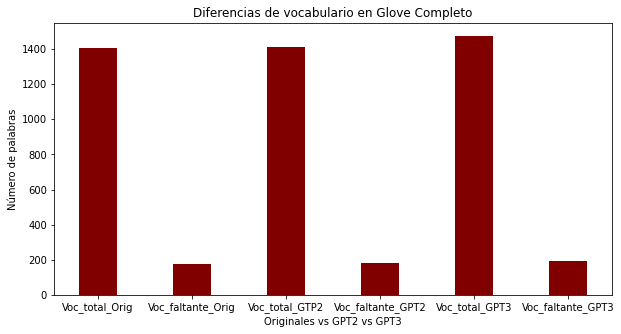

In [23]:
import numpy as np
import matplotlib.pyplot as plt
  
# creating the dataset
data = {'Voc_total_Orig':1406, 'Voc_faltante_Orig':174,'Voc_total_GTP2':1411, 'Voc_faltante_GPT2':180, 'Voc_total_GPT3':1474,'Voc_faltante_GPT3':192}
courses = list(data.keys())
values = list(data.values())
  
fig = plt.figure(figsize = (10, 5))
 
# creating the bar plot
plt.bar(courses, values, color ='maroon', width = 0.4)
 
plt.xlabel("Originales vs GPT2 vs GPT3")
plt.ylabel("Número de palabras")
plt.title("Diferencias de vocabulario en Glove Completo")
plt.show()